<a href="https://colab.research.google.com/github/lstarke/Fetal_Health_Classification/blob/main/LeandroStarke_Fetal_Health_Classification_(EDA).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Business Understanding

## Sobre o problema - Fetal Health Classification

<center><img src="https://drive.google.com/uc?export=view&id=1e9hCvGZM6nfwyuXF6lK4rOz0UbAkXc18" width="70%"></p></center>

Neste projeto será utilizado um dataset disponivel no Kaggle chamado [Fetal Health Classification](https://www.kaggle.com/datasets/andrewmvd/fetal-health-classification).

O dataset "Fetal Health Classification" é um conjunto de dados disponibilizado no Kaggle, que contém informações sobre a saúde fetal com base em sinais cardiotocográficos (CTGs)

O CTG é um procedimento médico que monitora a frequência cardíaca fetal e as contrações uterinas da mãe durante o trabalho de parto. Os sinais do CTG são registrados em um gráfico e fornecem informações importantes sobre a saúde fetal e a progressão do parto.

O objetivo do conjunto de dados é classificar o estado de saúde fetal em três categorias: Normal, Suspeito e Patológico. Essa classificação foi feita por especialistas com base em outras informações clínicas dos pacientes.

O conjunto de dados contém informações de 2.126 exames de CTG realizados em gestantes no Hospital Universitário de Zurique, na Suíça. Cada exame é composto por 22 variáveis, que incluem medidas de frequência cardíaca fetal, movimentos fetais, contrações uterinas, entre outras.

Esse conjunto de dados é útil para desenvolver modelos de aprendizado de máquina para classificação de saúde fetal, o que pode ajudar os profissionais de saúde a tomar decisões mais precisas e informadas durante o trabalho de parto.

# Data Understanding

In [ ]:
!pip install ydata-profiling

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


## Importação dos pacotes

In [ ]:
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns

from ydata_profiling  import ProfileReport

## Carregando dataset

In [ ]:
# carregando dataset
data = pd.read_csv("/content/fetal_health.csv")

# imprimindo 5 primeiras linhas
data.head()

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
0,120.0,0.000,0.0,0.000,0.000,0.0,0.0,73.0,0.5,43.0,...,62.0,126.0,2.0,0.0,120.0,137.0,121.0,73.0,1.0,2.0
1,132.0,0.006,0.0,0.006,0.003,0.0,0.0,17.0,2.1,0.0,...,68.0,198.0,6.0,1.0,141.0,136.0,140.0,12.0,0.0,1.0
2,133.0,0.003,0.0,0.008,0.003,0.0,0.0,16.0,2.1,0.0,...,68.0,198.0,5.0,1.0,141.0,135.0,138.0,13.0,0.0,1.0
3,134.0,0.003,0.0,0.008,0.003,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,11.0,0.0,137.0,134.0,137.0,13.0,1.0,1.0
4,132.0,0.007,0.0,0.008,0.000,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,9.0,0.0,137.0,136.0,138.0,11.0,1.0,1.0


## Shape

In [ ]:
# verificando dimensões do DataFrame
data.shape

(2126, 22)

## Features

In [ ]:
# listando nomes das colunas do DataFrame
list(data.columns)

['baseline value',
 'accelerations',
 'fetal_movement',
 'uterine_contractions',
 'light_decelerations',
 'severe_decelerations',
 'prolongued_decelerations',
 'abnormal_short_term_variability',
 'mean_value_of_short_term_variability',
 'percentage_of_time_with_abnormal_long_term_variability',
 'mean_value_of_long_term_variability',
 'histogram_width',
 'histogram_min',
 'histogram_max',
 'histogram_number_of_peaks',
 'histogram_number_of_zeroes',
 'histogram_mode',
 'histogram_mean',
 'histogram_median',
 'histogram_variance',
 'histogram_tendency',
 'fetal_health']

## Dicionário de variáveis

1. **baseline value** - FHR baseline (batimentos cardíacos fetais em repouso):

        Indica a frequência cardíaca basal fetal em batimentos por minuto (bpm).
1. **accelerations** - Número de acelerações do batimento cardíaco fetal (por segundo):
        Indica o número de acelerações registradas no batimento cardíaco fetal. As acelerações ocorrem quando a frequência
        cardíaca fetal aumenta em pelo menos 15 bpm em relação à linha de base e dura pelo menos 15 segundos.
1. **fetal_movement** - Número de movimentos fetais (por segundo):
        Indica o número de movimentos fetais registrados.
1. **uterine_contractions** - Frequência das contrações uterinas (por segundo):
        Indica a frequência das contrações uterinas em contrações por segundo.
1. **light_decelerations** - Diminuição temporária e leve na frequência cardíaca fetal (por segundo):

        Indica a quantidade de LDs ocorridas por segundo.

1. **severe_decelerations** - Diminuição significativa e prolongada na frequência cardíaca do feto durante o trabalho de parto (por segundo):

        Indica a quantidade de SDs ocorridas por segundo.

1. **prolongued_decelerations** - Diminuição significativa e prolongada na frequência cardíaca do feto durante o trabalho de parto que dura mais de 2 a 3 minutos (por segundo): 

        Indica a quantidade de PDs ocorridas por segundo.

1. **abnormal_short_term_variability** - Variação de curto prazo da frequência cardíaca fetal (em porcentagem):

        A variação normal da frequência cardíaca fetal é importante porque indica que o sistema nervoso fetal está funcionando
        adequadamente e que o feto está recebendo oxigênio e nutrientes suficientes.

1. **mean_value_of_short_term_variability** - Medida da variação da frequência cardíaca fetal:

         Observada em períodos curtos, geralmente de 30 segundos a 2 minutos.
         Indica o valor médio da variabilidade de curto prazo.

1. **percentage_of_time_with_abnormal_long_term_variability** - Variabilidade anormal de longo prazo: 

        Condição em que a frequência cardíaca fetal não apresenta a variação normal que é esperada durante períodos mais
        longos, geralmente de 2 a 10 minutos. Indica a porcentagem de tempo com variabilidade anormal de longo prazo.

1. **mean_value_of_long_term_variability** - Valor médio da variabilidade de longo prazo:

        Indica a média de variação da frequência cardíaca fetal que é observada em períodos mais longos, geralmente de 2 a 10 
        minutos.

1. **histogram_width** -  Largura do complexo QRS a partir de um histograma da frequência cardíaca fetal registrado durante o trabalho de parto:

        Indica a variação da frequência cardíaca fetal durante um determinado período de tempo.

1. **histogram_max** - Maior valor do sinal de ECG:

        Indica o maior valor do sinal de ECG registrado em microvolts.

1. **histogram_min** - Menor valor do sinal de ECG:

        Indica o menor valor do sinal de eletrocardiograma (ECG) registrado em microvolts.

1. **histogram_number_of_peaks** - Número de picos no sinal de ECG:

        Indica o número de picos no sinal de ECG.

1. **histogram_number_of_zeroes** - Número de zeros no sinal de ECG:

        É o número de vezes que o sinal de frequência cardíaca fetal atravessa a linha de base.

1. **histogram_mode** - É a moda da frequência cardíaca fetal
1. **histogram_mean** - É a média da frequência cardíaca fetal
1. **histogram_median** - É a mediana da frequência cardíaca fetal
1. **histogram_variance** - É a variância da frequência cardíaca fetal
1. **histogram_tendency** - É a tendência da frequência cardíaca fetal ao longo do tempo:

        Pode ser 0 (estável), 1 (crescente) ou -1 (decrescente).

1. **fetal_health** - a classificação de saúde fetal (ALVO):

        correspondente em uma das três classes: 
        * Normal (1), 
        * Suspeito (2),
        * Patológico (3)

## Relatório Pandas Profiling

In [ ]:
profile = ProfileReport(data, title="Fetal Health Classification EDA")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Analisando o relatório gerado pelo Pandas Profiling podemos destacar alguns pontos:

* O DataFrame não possui dados faltantes em suas colunas (Aparentemente);
* A tendência da frequencia cardíaca é estável ao longo do tempo;
* A variável alvo fetal_health está desbalanceada;
* Praticamente todas as variáveis tem alta correlação uma com as outras;

In [ ]:
# verificando dados NaN
data.isna().any()

baseline value                                            False
accelerations                                             False
fetal_movement                                            False
uterine_contractions                                      False
light_decelerations                                       False
severe_decelerations                                      False
prolongued_decelerations                                  False
abnormal_short_term_variability                           False
mean_value_of_short_term_variability                      False
percentage_of_time_with_abnormal_long_term_variability    False
mean_value_of_long_term_variability                       False
histogram_width                                           False
histogram_min                                             False
histogram_max                                             False
histogram_number_of_peaks                                 False
histogram_number_of_zeroes              

In [ ]:
# resumo da estrutura e das informações básicas dos dados
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2126 entries, 0 to 2125
Data columns (total 22 columns):
 #   Column                                                  Non-Null Count  Dtype  
---  ------                                                  --------------  -----  
 0   baseline value                                          2126 non-null   float64
 1   accelerations                                           2126 non-null   float64
 2   fetal_movement                                          2126 non-null   float64
 3   uterine_contractions                                    2126 non-null   float64
 4   light_decelerations                                     2126 non-null   float64
 5   severe_decelerations                                    2126 non-null   float64
 6   prolongued_decelerations                                2126 non-null   float64
 7   abnormal_short_term_variability                         2126 non-null   float64
 8   mean_value_of_short_term_variability  

## Describe do DataFrame

O método describe() do pandas é utilizado para gerar estatísticas descritivas de um DataFrame ou Series, incluindo contagem, média, desvio padrão, quartis e valores mínimos e máximos.

Por padrão, as estatísticas descritivas incluem a contagem, a média, o desvio padrão, o valor mínimo, o primeiro quartil, a mediana, o terceiro quartil e o valor máximo. No entanto, é possível personalizar as estatísticas descritivas usando argumentos opcionais, como percentis específicos para cálculo.

In [ ]:
# estatísticas descritivas
data.describe().T

,count,mean,std,min,25%,50%,75%,max
baseline value,2126.0,133.303857,9.840844,106.0,126.000,133.000,140.000,160.000
accelerations,2126.0,0.003178,0.003866,0.0,0.000,0.002,0.006,0.019
fetal_movement,2126.0,0.009481,0.046666,0.0,0.000,0.000,0.003,0.481
uterine_contractions,2126.0,0.004366,0.002946,0.0,0.002,0.004,0.007,0.015
light_decelerations,2126.0,0.001889,0.002960,0.0,0.000,0.000,0.003,0.015
severe_decelerations,2126.0,0.000003,0.000057,0.0,0.000,0.000,0.000,0.001
prolongued_decelerations,2126.0,0.000159,0.000590,0.0,0.000,0.000,0.000,0.005
abnormal_short_term_variability,2126.0,46.990122,17.192814,12.0,32.000,49.000,61.000,87.000
mean_value_of_short_term_variability,2126.0,1.332785,0.883241,0.2,0.700,1.200,1.700,7.000
percentage_of_time_with_abnormal_long_term_variability,2126.0,9.846660,18.396880,0.0,0.000,0.000,11.000,91.000


## Distribuição das classes

In [ ]:
data.fetal_health.value_counts()

1.0    1655
2.0     295
3.0     176
Name: fetal_health, dtype: int64

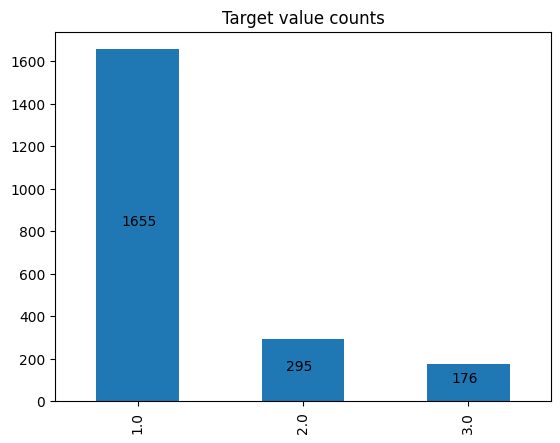

In [ ]:
# 1 = Normal 
# 2 = Suspeito 
# 3 = Patológico
ax = data.fetal_health.value_counts().plot(kind="bar", title="Target value counts");

# adicionando o valor em cada barra
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() + 0.15, p.get_height() / 2))

## Variáveis discretas

Variáveis discretas são aquelas que assumem um conjunto finito ou contável de valores, geralmente expressos em números inteiros. Esses valores não podem ser divididos em partes menores e não possuem uma ordem contínua. Exemplos de variáveis discretas incluem o número de filhos de uma família, o número de gols marcados em um jogo de futebol ou o número de lados de um dado. Em estatística, as variáveis discretas são frequentemente analisadas usando técnicas como tabelas de frequência, distribuições de probabilidade e testes estatísticos específicos para dados discretos.

In [ ]:
# comprehension list para identificar variáveis discretas dentre as variáveis numéricas encontradas
discrete_features = [feature for feature in data.columns if len(data[feature].unique()) < 25]

# imprimindo a quantidade de variáveis discretas
print(f"Qtde de variáveis discretas: {len(discrete_features)}")

# imprimindo as 5 primeiras linhas do DataFrame
data[discrete_features].head()

Qtde de variáveis discretas: 9


,accelerations,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_tendency,fetal_health
0,0.000,0.000,0.000,0.0,0.0,2.0,0.0,1.0,2.0
1,0.006,0.006,0.003,0.0,0.0,6.0,1.0,0.0,1.0
2,0.003,0.008,0.003,0.0,0.0,5.0,1.0,0.0,1.0
3,0.003,0.008,0.003,0.0,0.0,11.0,0.0,1.0,1.0
4,0.007,0.008,0.000,0.0,0.0,9.0,0.0,1.0,1.0


In [ ]:
# laço for para verificar valores únicos nas variáveis discretas
for discrete_feature in discrete_features:
  print(f"{discrete_feature}: {len(data[discrete_feature].unique())}")

accelerations: 20
uterine_contractions: 16
light_decelerations: 16
severe_decelerations: 2
prolongued_decelerations: 6
histogram_number_of_peaks: 18
histogram_number_of_zeroes: 9
histogram_tendency: 3
fetal_health: 3


Gráfico de densidade (Variáveis discretas)

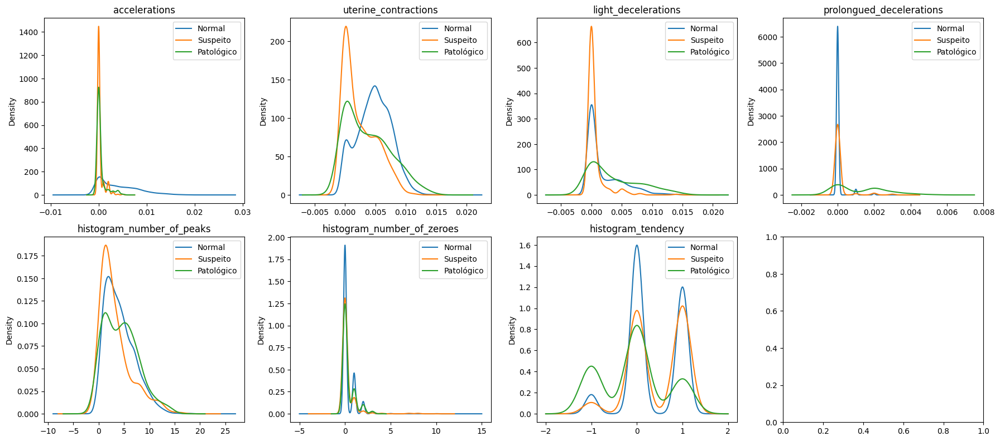

In [ ]:
# considerando somente as variáveis contínuas
features = data[discrete_features].drop(["severe_decelerations", "fetal_health"], axis=1).columns

# criando um grid de 15 posições 
fig, axs = plt.subplots(nrows=2, ncols=4, figsize=(18,8))

# plotando os gráficos em cada célula do grid
for ax, feature in zip(axs.flat, features):
  data[data.fetal_health == 1.0][feature].plot.kde(ax=ax, title=feature, label="Normal");
  data[data.fetal_health == 2.0][feature].plot.kde(ax=ax, title=feature, label="Suspeito");
  data[data.fetal_health == 3.0][feature].plot.kde(ax=ax, title=feature, label="Patológico");
  ax.legend()

fig.tight_layout(pad=1.0)

## Variáveis contínuas

Variáveis contínuas são aquelas que podem assumir qualquer valor dentro de um intervalo específico. Elas são medidas em uma escala contínua e podem assumir um número infinito de valores possíveis. Exemplos comuns de variáveis contínuas incluem altura, peso, temperatura, tempo e renda.

In [ ]:
# comprehension list para identificar variáveis discretas dentre as variáveis numéricas encontradas
continuous_features = [feature for feature in data.columns if feature not in discrete_features]

print(f"Qtde de variáveis contínuas = {len(continuous_features)}")
print(f"Variáveis contínuas: {continuous_features}")

Qtde de variáveis contínuas = 13
Variáveis contínuas: ['baseline value', 'fetal_movement', 'abnormal_short_term_variability', 'mean_value_of_short_term_variability', 'percentage_of_time_with_abnormal_long_term_variability', 'mean_value_of_long_term_variability', 'histogram_width', 'histogram_min', 'histogram_max', 'histogram_mode', 'histogram_mean', 'histogram_median', 'histogram_variance']


## Gráfico de densidade (Variáveis contínuas)

Um gráfico de densidade é uma visualização que mostra a distribuição de uma variável contínua. Ele pode ser muito útil na análise de dados, pois fornece informações importantes sobre a forma e a dispersão dos dados.

O gráfico de densidade pode ser útil na visualização da distribuição da variável alvo (```fetal_health```) em relação as variáveis independentes.

Por exemplo, se você estiver analisando a relação entre a idade e a renda em uma população, você pode plotar a densidade de renda para diferentes faixas etárias. Se houver uma forte correlação positiva entre idade e renda, é possível que as densidades de renda para faixas etárias mais avançadas sejam maiores do que para faixas etárias mais jovens.

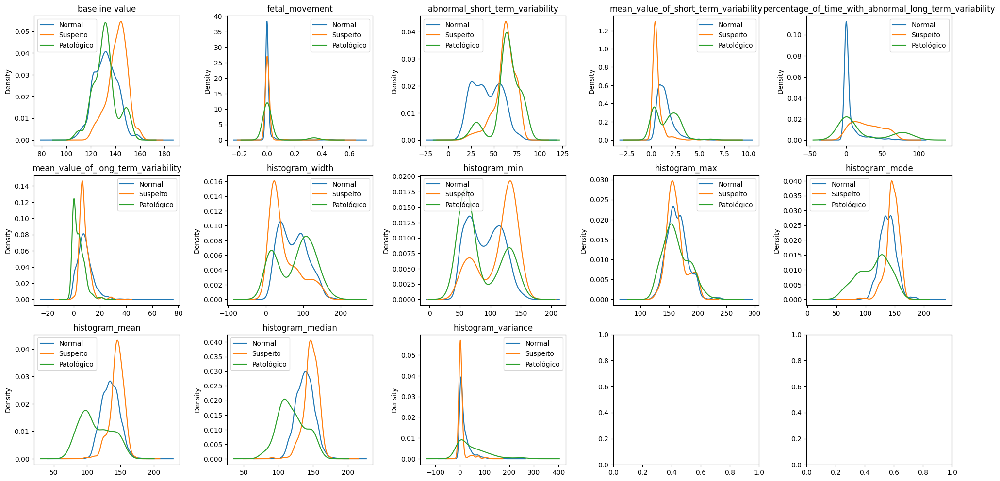

In [ ]:
# considerando somente as variáveis contínuas
features = data.drop(discrete_features, axis=1).columns

# criando um grid de 15 posições 
fig, axs = plt.subplots(nrows=3, ncols=5, figsize=(20,10))

# plotando os gráficos em cada célula do grid
for ax, feature in zip(axs.flat, features):
  data[data.fetal_health == 1.0][feature].plot.kde(ax=ax, title=feature, label="Normal");
  data[data.fetal_health == 2.0][feature].plot.kde(ax=ax, title=feature, label="Suspeito");
  data[data.fetal_health == 3.0][feature].plot.kde(ax=ax, title=feature, label="Patológico");
  ax.legend()

fig.tight_layout(pad=1.0)

Podemos concluir com os gráficos acima que as variáveis:

* ```baseline value```
* ```abnormal_short_term_variability```
* ```mean_value_of_short_term_variability```
* ```percentage_of_time_with_abnormal_long_term_variability```
* ```histogram_width```
* ```histogram_mode```
* ```histogram_mean```
* ```histogram_median```

podem explicar a variável alvo (```fetal_health```).



## Matriz de correlação

A matriz de correlação é uma tabela que mostra a relação entre as variáveis ​​de um conjunto de dados. Ela é utilizada para entender como as variáveis se relacionam entre si, e em particular, se elas estão positivamente correlacionadas (ou seja, aumentam juntas) ou negativamente correlacionadas (ou seja, uma diminui enquanto a outra aumenta) ou se elas não têm relação entre si (correlação nula).

Os valores na tabela indicam a medida de correlação entre as variáveis, que geralmente é calculada usando a fórmula de correlação de Pearson. Esses valores variam entre -1 e 1, onde -1 representa uma correlação negativa perfeita, 1 representa uma correlação positiva perfeita e 0 representa nenhuma correlação.

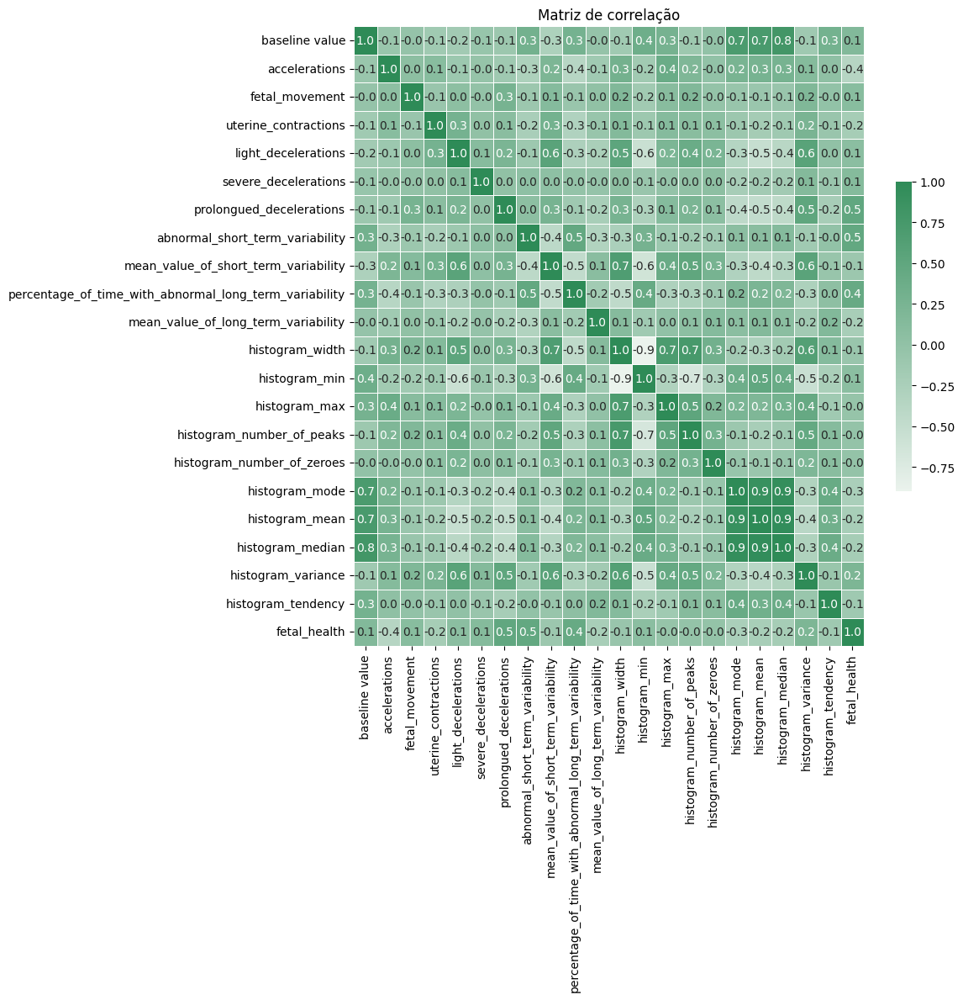

In [ ]:
# calculando a matriz de correlação
corr = data.corr()

# instanciamento objeto Figure e Axes do Matplotlib
fig, ax = plt.subplots(figsize=(12, 12))

cmap = sns.light_palette("seagreen", as_cmap=True)

# plotando a matriz de correlação
sns.heatmap(corr, cmap=cmap, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt='.1f', ax=ax);

# adicionando título
ax.set_title('Matriz de correlação');

plt.tight_layout()

Melhorando a visualização da matriz de correlação utilizando o atributo ```mask```.

Importante notar que, conforme documentação do seaborn, o atributo ```mask``` deve receber um array booleano e células iguais a ```True``` não serão plotadas.

Fonte: https://seaborn.pydata.org/generated/seaborn.heatmap.html

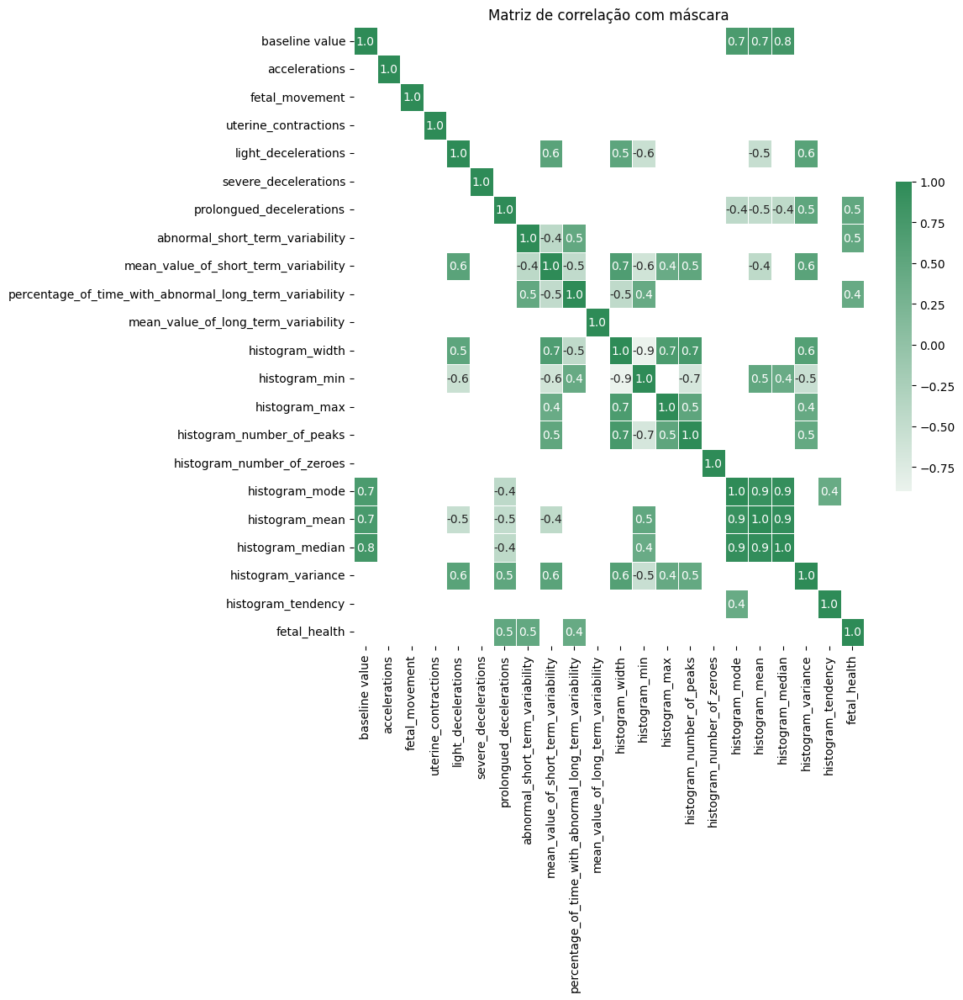

In [ ]:
# calculando a matriz de correlação
corr = data.corr()

mask = (corr <= -0.4) | (corr >= 0.4)

# instanciamento objeto Figure e Axes do Matplotlib
fig, ax = plt.subplots(figsize=(12, 12))

cmap = sns.light_palette("seagreen", as_cmap=True)

# plotando a matriz de correlação
sns.heatmap(corr, cmap=cmap, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt='.1f', ax=ax, mask=~mask);

# adicionando título
ax.set_title('Matriz de correlação com máscara');

plt.tight_layout()

In [ ]:
# filtrando variáveis com maior correção com a variável alvo
corr[corr[mask].fetal_health.notnull()].fetal_health

prolongued_decelerations                                  0.484859
abnormal_short_term_variability                           0.471191
percentage_of_time_with_abnormal_long_term_variability    0.426146
fetal_health                                              1.000000
Name: fetal_health, dtype: float64

Variáveis como ```prolongued_decelerations```,  ```abnormal_short_term_variability``` e  ```percentage_of_time_with_abnormal_long_term_variability``` estão fortemente correlacionadas com a variável alvo.


